# Geospatial Data Carpentry

For this Exercise, you will build on what you have learned of geospatial data and your previous data carpentry skills to acquire, stage, ingest, and render various datasets.

We will be accessing data linked at the US Government's Geospatial Platform: https://www.geoplatform.gov/


All the datasets will be in different formats. Some you may have seen, some will be new.
 * [New Mexico Populated Places (GNIS), 2009](https://web.dsa.missouri.edu/static/data/geodata/gnis_nm_populated_place.zip)
 * [Bureau of Land Management Land Grant Boundaries](https://web.dsa.missouri.edu/static/data/geodata/land_grants.original.zip)
 * https://web.dsa.missouri.edu/static/data/geodata/school_district_boundaries.derived.gml
 * https://web.dsa.missouri.edu/static/data/geodata/gpsrdsddshp.derived.kml

 
These datasets, while discoverable on geoplatform.gov have been hosted locally on Missouri servers to reduce the risk of the data not being available. 

## Exercise Prerequisite
In the module 2 practices, you ingested the first two data sources into PostGIS.
This is necessary for the completion of this exercise, as you will ingest additional files and then execute Geospatial queries against the ingested data.

# File 1: Geography Markup Format (GML) format

 * https://web.dsa.missouri.edu/static/data/geodata/school_district_boundaries.derived.gml

This file is a GML formatted file of school district boundaries.

Read about the GML format here: https://en.wikipedia.org/wiki/Geography_Markup_Language


Acquire and stage the GML into the `../temp/` folder as you did in the practices.


In [1]:
import os
import urllib.request
import shutil
import pandas as pd
from pathlib import Path
from zipfile import ZipFile

### Task: Aquire the File

In [2]:
## ----- Add Acquisition Code Below -----------

file_URL = 'https://web.dsa.missouri.edu/static/data/geodata/school_district_boundaries.derived.gml'

local_file_name = 'school_district_boundaries.derived.gml'

file_Path = Path('../temp/')  
file_Path /= local_file_name

with urllib.request.urlopen(file_URL) as response,  file_Path.open(mode='w+b') as out_file:
    shutil.copyfileobj(response, out_file)

You should then be able to peak at the first few lines of the file:

```BASH
$ head -n8 school_district_boundaries.gml
<?xml version="1.0" encoding="UTF-8"?>
    <gml:FeatureCollection 
        xmlns:gml="http://www.opengis.net/gml" 
        xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" 
        xmlns:xlink="http://www.w3.org/1999/xlink"
        xmlns:ogr="http://ogr.maptools.org/">
    <gml:description>NM School District Boundaries</gml:description>
    <gml:featureMember><ogr:g_school_district_boundaries><ogr:geometryProperty><gml:Polygon srsName="EPSG:4326"><gml:outerBoundaryIs><gml:LinearRing><gml:coordinates>-105.505039000052733,35.870676999750749 -105.354281999606613,35.870495999899177 ...
 -105.505039000052733,35.870676999750749</gml:coordinates></gml:LinearRing></gml:outerBoundaryIs></gml:Polygon></ogr:geometryProperty><ogr:id>18071698</ogr:id><ogr:COUNTY>San Miguel</ogr:COUNTY><ogr:CNTY_CODE>47</ogr:CNTY_CODE><ogr:DIST_CODE>69</ogr:DIST_CODE><ogr:NAMEPROPER>Las Vegas City</ogr:NAMEPROPER><ogr:Shape_Area>3283502950.87</ogr:Shape_Area><ogr:observed></ogr:observed></ogr:g_school_district_boundaries></gml:featureMember>
```

### Task: Explore the layers in the file, then load the data into a GeoPanda data frame.

In [3]:
## ----- Explore -----------
# Fill in the Filename as appropriate 
# based on acquisition above

GEODATA_FILE = '../temp/school_district_boundaries.derived.gml'


In [4]:
import fiona
numLayers = len(fiona.listlayers(GEODATA_FILE))
print("'{}' has {} layers".format(file_Path,numLayers))


'../temp/school_district_boundaries.derived.gml' has 1 layers


In [5]:
## ----- Load the dataframe -----------
# Load data into a dataframe called geo_df

import matplotlib.pyplot as plt
%matplotlib inline
import geopandas as gpd
geo_df = gpd.read_file(GEODATA_FILE, layer=0)
geo_df.head()

,gml_id,id,COUNTY,CNTY_CODE,DIST_CODE,NAMEPROPER,Shape_Area,geometry
0,None,18071698,San Miguel,47,69,Las Vegas City,3.283503e+09,"POLYGON ((-105.50504 35.87068, -105.35428 35.8..."
1,None,5754026,Colfax,7,8,Cimarron,3.729512e+09,"POLYGON ((-105.12024 36.99540, -105.06573 36.9..."
2,None,5754038,Union,59,84,Clayton,6.828298e+09,"POLYGON ((-103.00148 36.90955, -103.00176 36.9..."
3,None,5754066,Taos,55,76,Taos,1.647877e+09,"POLYGON ((-105.61667 36.62500, -105.58691 36.6..."
4,None,5754079,Mora,33,44,Mora,1.926289e+09,"POLYGON ((-105.17811 36.20281, -105.17512 36.2..."


## Explore the data



### Task: Plot the data using matplotlib

<AxesSubplot:>

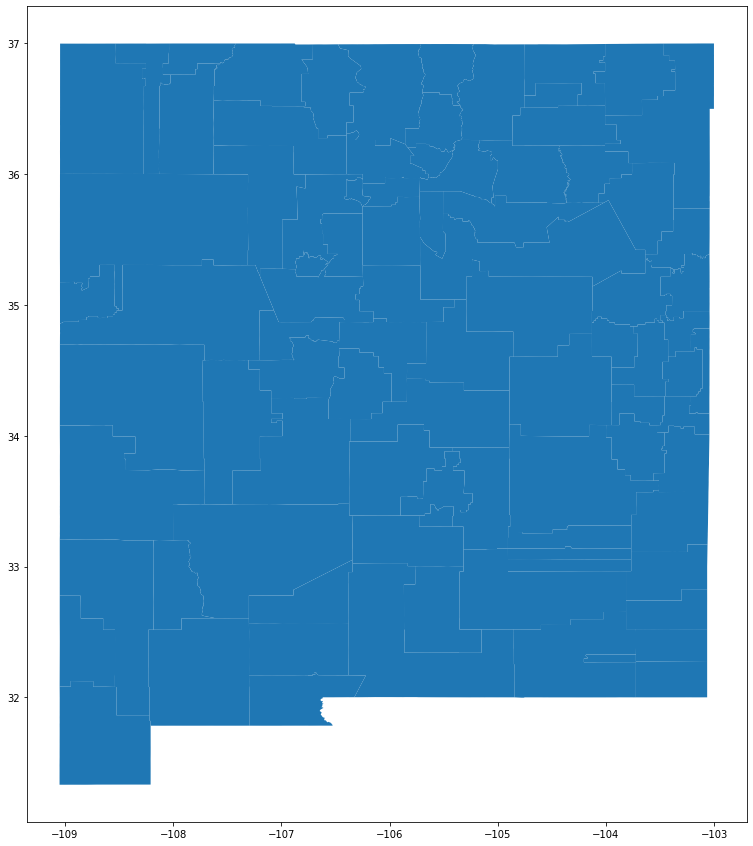

In [6]:
## ----- Plot the Data -----------

geo_df.plot(figsize=(15,15))

Now Let's see what kind of geometry data we have.

In [7]:
geo_df["geometry"].type.unique()

array(['Polygon', 'MultiPolygon'], dtype=object)

Notice that we have both Polygon and MultiPolygon data. Geopanda's can handle multiple types of geometry in the geometry column, or else we wouldn't have got this far. However, PostGIS cannot. If you would attempt to load your data in a PostGIS table the way it is you would get an error, the error would be determined by if you defined your geometry column as Polygon or MultiPolygon.

Because it is easier to define Polygons as MultiPolygon that is what we are going to do. But think about why this is and what you may have to do to go the other way.

In [8]:
## Changes the Polygon geometries to MultiPolygon
from shapely.geometry.multipolygon import MultiPolygon
from shapely.geometry.polygon import Polygon

geo_df["geometry"] = [MultiPolygon([feature]) if type(feature) == Polygon \
    else feature for feature in geo_df["geometry"]]

Now lets check the geometry again.

In [9]:
geo_df["geometry"].type.unique()

array(['MultiPolygon'], dtype=object)

### Task: Connect to the PostGIS database
Remember the POSTGIS database is just the PostgreSQL database that has the PostGIS extensions installed. 


In [2]:
## ----- Connect to POSTGIS -----------

import getpass
mypasswd = getpass.getpass()

········


In [3]:
import psycopg2
import numpy
from psycopg2.extensions import adapt, register_adapter, AsIs

connection = psycopg2.connect(database = 'dsa_student', 
                              user = 'rc25g', 
                              host = 'pgsql.dsa.lan',
                              password = mypasswd)
del mypasswd

### Task: Define your table, geometry column, and indexing

The table should be named: SSO.new_mexico_school_districts
Note that you should end up with a **coords** column that is a SRID=4326 MultiPolygon of 2-D (Lon,Lat).

In [12]:
geo_df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 89 entries, 0 to 88
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   gml_id      0 non-null      object  
 1   id          89 non-null     int64   
 2   COUNTY      89 non-null     object  
 3   CNTY_CODE   89 non-null     int64   
 4   DIST_CODE   89 non-null     int64   
 5   NAMEPROPER  89 non-null     object  
 6   Shape_Area  89 non-null     float64 
 7   geometry    89 non-null     geometry
dtypes: float64(1), geometry(1), int64(3), object(3)
memory usage: 5.7+ KB


In [57]:
## ----- Create Table -----------

sqlCreateTable = """
CREATE TABLE rc25g.new_mexico_school_districts (
  id SERIAL PRIMARY KEY,
  gml_id varchar(100),
  COUNTY varchar(100),
  CNTY_CODE int,
  DIST_CODE int,
  NAMEPROPER varchar(100),
  Shape_Area real
);
SELECT AddGeometryColumn('rc25g','new_mexico_school_districts','coords',4326,'MULTIPOLYGON',2);
CREATE INDEX idx_new_mexico_school_districts ON rc25g.new_mexico_school_districts USING GIST (coords);"""

with connection, connection.cursor() as cursor:
    
    cursor.execute(sqlCreateTable)

    connection.commit()

### Task: Load data into your Table

In [58]:
## ----- Load Data -----------


register_adapter(numpy.int64,AsIs)
register_adapter(numpy.float64,AsIs)

INSERT_SQL = 'INSERT INTO rc25g.new_mexico_school_districts '
INSERT_SQL += ' (gml_id,id,COUNTY,CNTY_CODE,DIST_CODE,NAMEPROPER,Shape_Area,coords) '
INSERT_SQL += ' values (%s,%s,%s,%s,%s,%s,%s,ST_GeomFromText(%s, 4326))'

with connection, connection.cursor() as cursor:
    for row in geo_df.itertuples():
        
    
        print(row) 
        
        
        data = (row.gml_id,row.id,row.COUNTY,row.CNTY_CODE,row.DIST_CODE,row.NAMEPROPER,row.Shape_Area,row.geometry.wkt)
        
        print(data)
        cursor.execute(INSERT_SQL,data)

Pandas(Index=0, gml_id=None, id=18071698, COUNTY='San Miguel', CNTY_CODE=47, DIST_CODE=69, NAMEPROPER='Las Vegas City', Shape_Area=3283502950.87, geometry=<shapely.geometry.multipolygon.MultiPolygon object at 0x7f17fa3dc9e8>)
(None, 18071698, 'San Miguel', 47, 69, 'Las Vegas City', 3283502950.87, 'MULTIPOLYGON (((-105.5050390000527 35.87067699975075, -105.3542819996066 35.87049599989918, -105.3472619994828 35.87065900003316, -105.3156789995989 35.86166299976377, -105.3152570005096 35.86128099978823, -105.2499999994781 35.84216400022207, -105.2472880001985 35.84128099988065, -105.2372499999391 35.83831000043559, -105.2366330003699 35.83884300009052, -105.2361269996942 35.83898100044381, -105.2352269995725 35.83888999990962, -105.2338209995409 35.83934800037393, -105.2333710000881 35.83927999969793, -105.2315710005096 35.83863899994966, -105.2296860005024 35.83751799955142, -105.2290669996983 35.83680800020041, -105.2278570001289 35.83651099969363, -105.2271539996017 35.83646500011169, -

Pandas(Index=69, gml_id=None, id=6385223, COUNTY='Eddy', CNTY_CODE=15, DIST_CODE=22, NAMEPROPER='Artesia', Shape_Area=7190843596.87, geometry=<shapely.geometry.multipolygon.MultiPolygon object at 0x7f17fad36a90>)
(None, 6385223, 'Eddy', 15, 22, 'Artesia', 7190843596.87, 'MULTIPOLYGON (((-104.9684909997158 33.13909900009609, -104.9363699557714 33.13886512810232, -104.9226245818193 33.13889721475163, -104.906885170755 33.13883779447907, -104.9054842289679 33.13883241070426, -104.9051333469757 33.05097768983644, -104.9051337388379 33.05079803372935, -104.9050924396571 33.03312551066657, -104.9051611446157 32.96289268887413, -104.8406293281917 32.96314024307424, -104.7843854626046 32.96340738271039, -104.749929389399 32.96339019279941, -104.6979653170622 32.96356109027072, -104.6547024547196 32.96357613915833, -104.6537821459227 32.9636728888163, -104.6444294612317 32.96364013314628, -104.6250232787466 32.96374520202028, -104.5937595537214 32.96381097268884, -104.5511484218325 32.963964742

### Check the data exists!

 * Replace SSO with your SSO

### Task Reconnect to POSTGIS

In [14]:
## ----- Reconnect to POSTGIS -----------
import getpass
mypasswd = getpass.getpass()

········


In [15]:
import psycopg2
import numpy
from psycopg2.extensions import adapt, register_adapter, AsIs

connection = psycopg2.connect(database = 'dsa_student', 
                              user = 'rc25g', 
                              host = 'pgsql.dsa.lan',
                              password = mypasswd)
del mypasswd

In [13]:
sqlSelect = """
select count(*) 
 from rc25g.new_mexico_school_districts;"""

gdf=pd.read_sql_query(sqlSelect,connection)
gdf.head()

,count
0,89


The output should be 89 rows.

In [14]:
sqlSelect = """
select id,COUNTY,CNTY_CODE,DIST_CODE
      ,NAMEPROPER,Shape_Area,st_area(coords) 
 from rc25g.new_mexico_school_districts 
 limit 10;"""

with connection, connection.cursor() as cursor:

    cursor.execute(sqlSelect)

    cursor.fetchall()
    
gdf=pd.read_sql_query(sqlSelect,connection)
gdf.head(10)

,id,county,cnty_code,dist_code,nameproper,shape_area,st_area
0,18071698,San Miguel,47,69,Las Vegas City,3.283500e+09,0.327119
1,5754026,Colfax,7,8,Cimarron,3.729510e+09,0.376030
2,5754038,Union,59,84,Clayton,6.828300e+09,0.685897
3,5754066,Taos,55,76,Taos,1.647880e+09,0.165644
4,5754079,Mora,33,44,Mora,1.926290e+09,0.192730
5,5754099,Sierra,51,73,T or C,1.098010e+10,1.060674
6,6159255,Rio Arriba,39,54,Dulce,3.566630e+09,0.359922
7,6163079,Farmington,45,64,Aztec,1.128420e+09,0.113989
8,6166818,Farmington,45,65,Farmington,2.039180e+09,0.205178
9,6170323,San Juan,45,67,Central,7.300040e+09,0.732715


### Task: Query the database to answer a couple questions:

#### List the counties with more than 3 school districts, in descending order by number of school districts, then in alphabetic order within a group of the same number of school districts.

In [6]:
## ----- Add SQL Code Below -----------

sqlSelect = """
select county, COUNT(dist_code)
 from rc25g.new_mexico_school_districts
 Group by county
 Having COUNT(dist_code) > 3
 Order by COUNT(dist_code) DESC
 ;"""
gdf=pd.read_sql_query(sqlSelect,connection)

sqlSelect = """
select county, COUNT(dist_code)
 from rc25g.new_mexico_school_districts
 Group by county
 Having COUNT(dist_code) > 3
 Order by county ASC
 ;"""
gdf2=pd.read_sql_query(sqlSelect,connection)

from IPython.display import display

display(gdf.head(10))
display(gdf2.head(10))

,county,count
0,Lea,5
1,Curry,4
2,Roosevelt,4
3,Rio Arriba,4
4,Sandoval,4
5,Lincoln,4
6,Quay,4
7,Taos,4
8,Colfax,4
9,Chaves,4


,county,count
0,Chaves,4
1,Colfax,4
2,Curry,4
3,Lea,5
4,Lincoln,4
5,Quay,4
6,Rio Arriba,4
7,Roosevelt,4
8,Sandoval,4
9,Taos,4


#### List the top 5 school districts, in descending order by number of populated places.

In [7]:
## ----- Add SQL Code Below -----------

sqlSelect = """
select A.DIST_CODE, Count(*)
 from rc25g.new_mexico_school_districts as A
 JOIN rc25g.new_mexico_populated_places as B ON ST_Contains(A.coords,B.coords)
 Group by DIST_CODE
 Order by Count(*) DESC
 ;"""
    
gdf=pd.read_sql_query(sqlSelect,connection)
gdf.head()

,dist_code,count
0,1,74
1,43,73
2,68,69
3,55,66
4,88,55


#### (Optional): List the top 3 counties based on total size of school districts, in descending order by size.  List the size in square kilometers!

In [12]:
## ----- Add SQL Code Below -----------

sqlSelect = """
select county, .000001 *  SUM(shape_area) as sqr_km
 from rc25g.new_mexico_school_districts
 Group by county
 Order by SUM(shape_area) DESC
 ;"""
    
gdf=pd.read_sql_query(sqlSelect,connection)
gdf.head(3)

,county,sqr_km
0,Catron,19565.453312
1,Otero,16972.896256
2,McKinley,14491.773952


Expected Answer:

```SQL
  county  |      sqr_km      
----------+------------------
 Catron   | 19532.8696952213
 Otero    |  16983.887376987
 McKinley |  14471.088162269
(3 rows)
```

---

# File 2: Keyhole Markup Language (KML) format

 * https://web.dsa.missouri.edu/static/data/geodata/gpsrdsddshp.derived.kml
 
This file is a KML formatted file of GPS coordinates of roads in New Mexico.
Read more [here](https://catalog.data.gov/dataset/gps-roads).

KML is a file format used to display geographic data in an Earth browser such as Google Earth. 
KML uses a tag-based structure with nested elements and attributes and is based on the XML standard. 
All tags are case-sensitive and must appear exactly as they are listed in the KML Reference. 

Read about KML [here](https://developers.google.com/kml/documentation/kml_tut)

### Task: Acquire and stage the KML into the `../temp/` folder as you did in the practices.



In [5]:
## ----- Add Acquisition Code Below -----------

file_URL = 'https://web.dsa.missouri.edu/static/data/geodata/gpsrdsddshp.derived.kml'

local_file_name = 'gpsrdsddshp.derived.kml'

file_Path = Path('../temp/')  
file_Path /= local_file_name

with urllib.request.urlopen(file_URL) as response,  file_Path.open(mode='w+b') as out_file:
    shutil.copyfileobj(response, out_file)

### Task: Confirm the file name looks correct and then examin the file with Fiona

In [6]:
GEODATA_FILE = '../temp/gpsrdsddshp.derived.kml'

import fiona
numLayers = len(fiona.listlayers(GEODATA_FILE))
print("'{}' has {} layers".format(file_Path,numLayers))

'../temp/gpsrdsddshp.derived.kml' has 1 layers


### Now attempt to load the file into a geopandas data frame (expect an error)

In [17]:
import geopandas as gpd
geo_df = gpd.read_file(GEODATA_FILE, layer=0)
geo_df.tail()

DriverError: unsupported driver: 'KML'

### We get this error because KML is not supported by Fiona. 
So, we have a file that looks like XML that we cannot use a simple library to load it into GeoPandas.
You will need to recall your previous experience in classes and doing data carpentry.
KML is a hierarchical [Document Object Model (DOM)](https://www.w3.org/TR/WD-DOM/introduction.html) similar to [HTML](https://www.w3schools.com/html/), as it is a type of [XML](https://www.w3schools.com/xml/xml_whatis.asp).

## Processing 

Basically, KML is similar in nature to GML.  
So, for the last file you will repeat the exercise above with a changes necessary to import KML instead of GML and into a new table.

The elements we will process are **`Placemark`**s.
These Placemarks have **`LineString`** geometries with a **`coordinates`** list.
```
<Placemark id="17948705"><name>17948705</name>
   <LineString><coordinates>-107.915138244628793,36.809299468994105 -107.915 ... </coordinates></LineString>
   <ExtendedData><SchemaData schemaUrl="#attributes">
     <SimpleData name="NAME">I 40</SimpleData>
     <SimpleData name="TYPE">State Highway</SimpleData>
...
</Placemark>
```
  * There are numerous additional fields, however we will limit our parsing and loading to the Name and Type.

Programmatically, we must do the following:
 1. Parse file into a DOM
 1. Find all `<Placemark>`
 1. Parse each **`Placemark`** into a record with:
    * LineString
    * Name
    * Road Type
 1. Add each record into the database


### Task: Define your table, geometry column, and indexing

Write your SQL Statements below, then copy-and-paste into the terminal database command line.

Note that you should end up with a **coords** column that is a SRID=4326 LINESTRINF of 2-D (Lon,Lat).

In [ ]:
## ----- create table ----------

"""
CREATE TABLE rc25g.new_mexico_gps_coords (
  NAME varchar(100),
  Road_Type varchar(100)
);
SELECT AddGeometryColumn('rc25g','new_mexico_gps_coords','coords',4326,'LINESTRING',2);
CREATE INDEX idx_new_mexico_gps_coords ON rc25g.new_mexico_gps_coords USING GIST (coords);
"""

### Task: Load the table with geospatial data!

 * **NOTE:** You may need to rerun the DB Connection Cell again
 

In [2]:
import getpass
mypasswd = getpass.getpass()

········


In [3]:
import psycopg2
import numpy
from psycopg2.extensions import adapt, register_adapter, AsIs

connection = psycopg2.connect(database = 'dsa_student', 
                              user = 'rc25g', 
                              host = 'pgsql.dsa.lan',
                              password = mypasswd)
del mypasswd

In [7]:
# ---- Write the code for the insert statement.

from bs4 import BeautifulSoup
from shapely.geometry import LineString

with open(GEODATA_FILE, encoding='latin1') as file, connection, connection.cursor() as cursor:
    
    print("Parsing file")
    soup = BeautifulSoup(file.read(), 'html')
    print("DOM created")
    
    for ft in soup.find_all('placemark'):
        linestring = ft.find('linestring')
        coords = linestring.find('coordinates').text
        print(type(linestring))
        print(type(coords))
        
        coords =  coords.split(' ')
        coords_tuple = [(float(c.split(',')[0]),float(c.split(',')[1])) for c in coords]
        coords = LineString(coords_tuple)
        print(coords.wkt)
        
        ed = ft.find('extendeddata')
        print(ed)
        
        ## Replace XXX here 
        name = ed.find('simpledata', {'name':'NAME'}).text
        road_type = ed.find('simpledata', {'name':'TYPE'}).text
        print("Road {} ({})".format(name,road_type))
        
        data = (name,road_type,coords.wkt)
        
        INSERT_SQL = 'INSERT INTO rc25g.new_mexico_gps_coords '
        INSERT_SQL += ' (name,road_type,coords) '
        INSERT_SQL += ' values (%s,%s,ST_GeomFromText(%s, 4326))'

        ## Replace XXX here    
        cursor.execute(INSERT_SQL,data)
    print("Data Loaded")

Parsing file
DOM created
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-105.217300415039 34.98764419555661, -105.2171173095702 34.98763275146481, -105.2166442871093 34.98761749267575, -105.216209411621 34.98759841918942, -105.2157669067382 34.98757171630856, -105.2153167724608 34.9875450134277, -105.2148437499999 34.98752593994137, -105.214385986328 34.98750305175778, -105.2139282226562 34.98748397827145, -105.2134704589843 34.98746109008786, -105.2129974365233 34.98744583129879, -105.212547302246 34.98742675781246, -105.2120895385741 34.98741912841793, -105.2116394042968 34.98740768432614, -105.2111740112304 34.98739242553707, -105.2107086181639 34.98736953735348, -105.2102661132812 34.98734664916989, -105.2098236083983 34.98732757568356, -105.2094955444335 34.9873123168945, -105.2090301513671 34.9872894287109, -105.2085876464843 34.98725509643551, -105.2081298828124 34.98721313476559, -105.2076873779296 34.9871788024902, -105.2072601318358 34.98715591430661, -105.2068099975585 

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.9151382446288 36.80929946899411, -107.9153060913085 36.808723449707, -107.9151611328124 36.80846405029293, -107.9150085449218 36.80822753906246, -107.9148406982421 36.80796051025386, -107.9146575927733 36.80767059326168, -107.9145050048827 36.80743408203121, -107.9143447875975 36.80718612670894, -107.9141845703124 36.80692672729489, -107.9140090942382 36.80665206909176, -107.9138259887694 36.80636215209957, -107.9136352539061 36.80606460571286, -107.9134292602538 36.80575561523433, -107.913230895996 36.80546188354489, -107.9130477905272 36.8051719665527, -107.9128570556639 36.80487823486325, -107.9126663208007 36.80458450317379, -107.9124908447264 36.80428695678707, -107.9122848510741 36.80400466918942, -107.9121017456054 36.80372619628903, -107.9119110107421 36.8034515380859, -107.9117355346679 36.8031959533691, -107.9115676879882 36.80292892456051, -107.9114151000975 36.80266952514644, -107.911277770996 36.80242156982418, -107.

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7702178955077 32.28131484985349, -106.7703857421874 32.28136825561521)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">8254.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">8252.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">10747.0</simpledata>
<simpledata name="GPSRDSDD_I">200.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road  (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5851135253905 35.16706466674801, -106.5838928222655 35.16706466674801)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SAN FRANCISCO RD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simp

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-105.0308303833007 35.74314117431637, -105.0307998657226 35.7431602478027)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">809.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">808.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">1033.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road  (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-105.1002502441405 35.69969558715817, -105.100357055664 35.69994354248043)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">FR2147</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNOD

LINESTRING (-106.5688323974608 35.11943054199215, -106.5688095092772 35.12061691284176)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">LOUISIANA BLVD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">3241.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">3203.0</simpledata>
<simpledata name="ALT_NAME">FL4057</simpledata>
<simpledata name="GPSRDSDD_">4225.0</simpledata>
<simpledata name="GPSRDSDD_I">10495.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road LOUISIANA BLVD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6564025878905 35.11820602416989, -106.6561126708983 35.1191368103027)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">12TH ST</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="

Road I 25 (Interstate)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.4041519165038 35.41717529296871, -106.4044113159179 35.41732406616207, -106.4046630859374 35.41746139526364, -106.404930114746 35.41762161254879, -106.4050064086913 35.41765594482418)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">FR2085</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">1532.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">1529.0</simpledata>
<simpledata name="ALT_NAME">FR2532</simpledata>
<simpledata name="GPSRDSDD_">2113.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road FR2085 (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6472091674804 35.20323562622067, -106.6469726562499 35.20357131958004, -106

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.0804214477538 35.99018478393551, -106.0804214477538 35.98963165283199, -106.0804061889647 35.98929214477536, -106.0804061889647 35.98899459838864, -106.0804061889647 35.98865890502926, -106.0804061889647 35.98832702636715, -106.0804061889647 35.98806762695309)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">NM 30</simpledata>
<simpledata name="TYPE">State Highway</simpledata>
<simpledata name="FNODE_">657.0</simpledata>
<simpledata name="LENGTH">0.002</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">662.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">841.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road NM 30 (State Highway)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-104.4320449829101 36.882133483

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-108.6734771728514 35.53070831298824, -108.6733093261718 35.53073120117184, -108.6730041503905 35.53076171874996, -108.6719970703124 35.53087234497067)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">NM 118</simpledata>
<simpledata name="TYPE">State Highway</simpledata>
<simpledata name="FNODE_">1130.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">1129.0</simpledata>
<simpledata name="ALT_NAME">BL00031; AVENUE 66</simpledata>
<simpledata name="GPSRDSDD_">1514.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road NM 118 (State Highway)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-108.6550292968749 35.53169250488278, -108.6550445556639 35.53151321411129, -108.6550674438475 35.53139877319332, -108.655

LINESTRING (-108.7268295288085 35.53341293334957, -108.7275390624999 35.5333976745605, -108.7279510498046 35.53339385986325, -108.7283477783202 35.53338241577145, -108.7287673950194 35.53338623046871, -108.7291793823241 35.53338623046871, -108.7295989990233 35.53339004516598, -108.730010986328 35.53339385986325, -108.7304077148437 35.53339004516598, -108.7308120727538 35.53338241577145, -108.7312240600585 35.53337478637692, -108.7316131591796 35.53335952758786, -108.7320480346679 35.53332519531246, -108.7327041625975 35.53324890136715)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">I 40</simpledata>
<simpledata name="TYPE">Interstate</simpledata>
<simpledata name="FNODE_">1094.0</simpledata>
<simpledata name="LENGTH">0.006</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">1093.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">1466.0</simpledata>
<sim

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.2483978271483 35.50236511230465, -106.2444686889647 35.50628662109371, -106.2441177368163 35.50658035278317, -106.2437667846679 35.50686264038082, -106.2434463500976 35.50711441040036, -106.2430877685546 35.50737380981442, -106.2427368164062 35.50761032104489, -106.2423782348632 35.50785064697262, -106.2420196533202 35.50807189941403, -106.2413330078124 35.50846862792965, -106.2409667968749 35.5086631774902, -106.2405776977538 35.50886917114254, -106.2401962280272 35.50905227661129, -106.2398071289062 35.50923919677731, -106.2393798828124 35.50944137573239, -106.2389984130858 35.50962066650387, -106.2385787963866 35.50981521606441, -106.238182067871 35.51000213623043, -106.2377471923827 35.51020431518551, -106.2373733520507 35.51038742065426, -106.2369461059569 35.51058197021481, -106.2364196777343 35.5108375549316, -106.2360000610351 35.51103591918942, -106.2356033325194 35.5112266540527, -106.2351608276366 35.51143264770504, -1

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5967330932616 35.20795059204098, -106.5967712402343 35.20796203613278, -106.597183227539 35.20809555053707, -106.5976028442382 35.2082366943359, -106.5979919433593 35.20838546752926, -106.5983963012694 35.20854187011715, -106.5988006591796 35.20870971679684, -106.5992126464843 35.20888519287106, -106.5996170043944 35.20904541015621, -106.6000289916991 35.20919799804684, -106.6004333496093 35.20936203002926, -106.6007614135741 35.20950698852536, -106.6010665893554 35.20963287353512, -106.6015090942382 35.20980834960934, -106.6018676757811 35.20991897583004, -106.6022491455077 35.20999908447261, -106.6026382446288 35.21000289916989, -106.6030426025389 35.20996475219723)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">ROY AVE</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">1837.0</simpledata>
<simpledata name="LENGTH">0.007</simpledata>
<simpledata name="LPOLY_">0.0</s

LINESTRING (-106.5474395751952 35.11640167236325, -106.5464630126952 35.11639785766598)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">CANDELARIA BLVD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">3350.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">3352.0</simpledata>
<simpledata name="ALT_NAME">FL4048</simpledata>
<simpledata name="GPSRDSDD_">4344.0</simpledata>
<simpledata name="GPSRDSDD_I">11114.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road CANDELARIA BLVD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5464630126952 35.11639785766598, -106.5447463989257 35.11635208129879)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">CANDELARIA BLVD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simple

LINESTRING (-106.6604766845702 35.08267974853512, -106.6616668701171 35.08282470703121)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">LEAD AVE</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">4799.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">4792.0</simpledata>
<simpledata name="ALT_NAME">FL4030</simpledata>
<simpledata name="GPSRDSDD_">6102.0</simpledata>
<simpledata name="GPSRDSDD_I">18761.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road LEAD AVE (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5861892700194 35.08367156982418, -106.5861968994139 35.08498764038082)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SAN MATEO BLVD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNOD

LINESTRING (-105.5463638305663 35.00407791137692, -105.5462036132811 35.00387954711911, -105.5461578369139 35.00382232666012)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">FR4073</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">5998.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">6002.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">7605.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road FR4073 (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6937866210936 34.94829940795895, -106.6936798095702 34.94785308837887)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">ISLETA BLVD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<si

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.8937225341796 34.0735931396484, -106.8936767578124 34.07338333129879, -106.8935775756835 34.07297897338864)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">US 60</simpledata>
<simpledata name="TYPE">US Highway</simpledata>
<simpledata name="FNODE_">6760.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">6763.0</simpledata>
<simpledata name="ALT_NAME">BL00012</simpledata>
<simpledata name="GPSRDSDD_">8681.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road US 60 (US Highway)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-103.2142028808593 34.41934585571286, -103.2311553955077 34.41938400268551, -103.2317352294921 34.4192962646484)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name=

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-104.5364151000975 33.35053253173825, -104.5368194580077 33.35051727294918, -104.5371170043944 33.35050582885739, -104.5375442504882 33.35049438476559, -104.5379791259764 33.35047912597653, -104.5383529663085 33.350471496582, -104.5387496948241 33.35045242309567, -104.5391464233397 33.35043334960934, -104.539566040039 33.35041809082028, -104.5399475097655 33.35041046142575, -104.540313720703 33.35038757324215, -104.5406570434569 33.35037612915036, -104.5409698486327 33.35035705566403, -104.5413055419921 33.35034561157223, -104.5416793823241 33.35033035278317)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">BRASHER ST</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">7056.0</simpledata>
<simpledata name="LENGTH">0.005</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">7058.0</simpledata>
<simpledata n

LINESTRING (-107.2619400024413 32.78239822387692, -107.2628479003905 32.78303527832028, -107.2630462646483 32.78317642211911, -107.2632522583007 32.7833099365234, -107.263458251953 32.7834548950195, -107.2636489868163 32.78357315063474, -107.263816833496 32.7836761474609, -107.2639770507811 32.78378677368161, -107.2641067504882 32.78388595581052, -107.2642974853514 32.78399658203121, -107.2644424438476 32.78410720825192, -107.264549255371 32.78419494628903)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">7464.0</simpledata>
<simpledata name="LENGTH">0.003</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">7460.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">9606.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata>

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7636489868163 32.32979965209957, -106.7637405395507 32.33007049560543, -106.7639770507811 32.33056640624997, -106.7643737792968 32.33110046386715, -106.7648544311522 32.33148193359372, -106.7652664184569 32.33172225952145, -106.7659606933593 32.33216857910153, -106.7663269042968 32.33248138427732, -106.7665405273437 32.33272933959958, -106.7667007446288 32.33304595947262)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">EVELYN ST</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">7886.0</simpledata>
<simpledata name="LENGTH">0.005</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">7871.0</simpledata>
<simpledata name="ALT_NAME">FL5564</simpledata>
<simpledata name="GPSRDSDD_">10185.0</simpledata>
<simpledata name="GPSRDSDD_I">400.0</simpledata>
<simpledata name="observed"></simpledata></schemadata

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6033096313475 32.04898071289059, -106.6033325195311 32.04939651489255, -106.6033325195311 32.04974746704098, -106.6033096313475 32.05009460449216, -106.603302001953 32.05045318603512, -106.6032714843749 32.05080795288082, -106.6032104492186 32.05116271972653, -106.6031265258788 32.05149078369137, -106.6030426025389 32.05181884765621, -106.6029129028319 32.05212783813474, -106.6027755737304 32.05242919921872, -106.6026763916014 32.05266189575192)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">NM 460</simpledata>
<simpledata name="TYPE">State Highway</simpledata>
<simpledata name="FNODE_">8569.0</simpledata>
<simpledata name="LENGTH">0.004</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">8566.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">11216.0</simpledata>
<simpledata name="GPSRDSDD_I">200

LINESTRING (-108.397117614746 34.6008148193359, -108.3972549438475 34.6008148193359, -108.3976364135741 34.60079956054684, -108.3979949951171 34.60076904296871, -108.3983688354491 34.60073471069332, -108.398712158203 34.60066604614254, -108.3990783691405 34.60060882568356, -108.3994064331054 34.60054397583004, -108.3997421264647 34.60046386718746, -108.4000854492186 34.60040283203121, -108.4004135131835 34.6003265380859, -108.4007492065429 34.60025405883786, -108.4011230468749 34.60016632080075, -108.4014434814452 34.6000938415527, -108.4017791748046 34.60003662109371, -108.4021072387694 34.59995651245114, -108.4024353027343 34.59989166259762, -108.4027786254882 34.59981918334957, -108.4030990600585 34.59974670410153, -108.4034118652343 34.59968948364254, -108.4037551879882 34.5996170043945, -108.404083251953 34.59957504272457, -108.4044265747069 34.59953689575192, -108.4047622680663 34.59950637817379, -108.4051284790038 34.59951782226559, -108.4054641723632 34.59952926635739, -108.405

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



LINESTRING (-104.0085449218749 36.87075424194332, -104.0083389282226 36.87075424194332, -104.0078735351561 36.87075042724606, -104.0073699951171 36.87075805664058, -104.0066299438475 36.87084197998043, -104.0062561035155 36.87089920043941, -104.0057754516601 36.87097549438473, -104.0053100585936 36.87104034423825, -104.0048370361327 36.8710784912109, -104.004295349121 36.87102890014645, -104.0037536621093 36.87091827392574, -104.003204345703 36.87080383300778, -104.0026626586913 36.87068939208981, -104.0021133422851 36.87054443359371, -104.0016479492187 36.87037658691403, -104.0012130737304 36.87021255493161, -104.0008087158202 36.87007141113278, -104.0004196166991 36.86995697021481, -104.0000534057616 36.86992645263668, -103.9996490478514 36.86994171142574, -103.9991989135741 36.86996841430661, -103.9986495971679 36.8699913024902, -103.9979782104491 36.87003326416012, -103.9974441528319 36.87005615234371, -103.9969177246093 36.87007522583004, -103.9963378906249 36.87009811401364, -103

LINESTRING (-108.1843719482421 36.73731994628902, -108.184356689453 36.73792266845699, -108.1843643188475 36.73822402954097, -108.1843643188475 36.73859405517575, -108.1843643188475 36.73884963989254, -108.1843643188475 36.73911666870113, -108.184356689453 36.73939514160153, -108.1843490600585 36.73967742919918, -108.1843490600585 36.73996353149411, -108.1843490600585 36.74026870727535, -108.1843338012694 36.74064254760739, -108.1843261718749 36.74095916748043, -108.1843261718749 36.7413177490234, -108.1843185424804 36.74166107177731, -108.1843185424804 36.74199676513668, -108.1842956542968 36.74232101440426, -108.1842880249022 36.74263000488278, -108.1842727661132 36.74291610717769, -108.1842727661132 36.74320602416988, -108.1842575073241 36.74349594116207, -108.1842651367186 36.74380874633785, -108.1842575073241 36.7441368103027, -108.1842346191405 36.74461746215817, -108.184226989746 36.74494934082027, -108.1842193603514 36.74527359008786, -108.1842193603514 36.74567413330075, -108.

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5353698730468 36.7427940368652, -106.5353851318358 36.74250793457027, -106.5354537963866 36.74221801757809, -106.5354690551757 36.7419395446777, -106.5354003906249 36.74166488647457, -106.5352096557616 36.7414398193359, -106.5349655151366 36.74126052856442, -106.5346908569335 36.74109649658199, -106.5344085693358 36.74092483520504, -106.5341567993163 36.74072265624996, -106.5340652465819 36.74047470092769, -106.5341796874999 36.74021530151363, -106.534324645996 36.73999023437496, -106.5344467163085 36.73976516723629, -106.534568786621 36.73952484130856, -106.5346908569335 36.73928833007809, -106.5348205566405 36.73905563354489, -106.5349044799804 36.73880386352536, -106.5350646972655 36.73846817016598, -106.5351638793944 36.73827743530269, -106.535316467285 36.7380332946777, -106.5355148315429 36.7377891540527, -106.5354995727538 36.73775482177731, -106.5355377197265 36.73754882812496, -106.535430908203 36.73736953735348, -106.53

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.8095169067382 36.35976791381832, -107.8105316162108 36.35898590087887, -107.8110351562499 36.35856628417965, -107.8112792968749 36.35836410522457, -107.8115386962889 36.35813903808589, -107.8120193481444 36.35773468017575, -107.8123168945311 36.35747909545895, -107.8126144409179 36.35721969604489, -107.8129348754882 36.35695266723629, -107.8131713867186 36.35673904418942, -107.8134841918944 36.35647964477536, -107.8137893676757 36.35621261596676, -107.8140792846679 36.35595703124996, -107.8143844604491 36.35569763183589, -107.8146743774413 36.35544204711911, -107.8149871826171 36.35517120361324, -107.8152847290038 36.35490417480465, -107.815574645996 36.35466384887691, -107.8158569335937 36.35442352294918, -107.8161315917968 36.35417556762692, -107.8164215087889 36.35392761230465, -107.8167114257811 36.35368728637692, -107.8169479370116 36.35348510742184, -107.8172378540038 36.3532333374023, -107.8174514770507 36.35305023193355, 

LINESTRING (-104.806671142578 36.2176361083984, -104.8067779541014 36.21733474731442, -104.8068466186522 36.21706771850582, -104.8068923950194 36.21679687499996, -104.8068771362304 36.21651840209957, -104.8068695068358 36.21622848510739, -104.8068695068358 36.21592330932613, -104.8068771362304 36.21562576293942, -104.8068771362304 36.21530914306637, -104.8068923950194 36.21496963500973, -104.8068923950194 36.21464920043942, -104.8068923950194 36.2143402099609, -104.8068923950194 36.21401977539058, -104.8068923950194 36.21369552612301, -104.8069000244139 36.21338272094723, -104.8069000244139 36.21308517456051, -104.8068923950194 36.21277236938472, -104.8069000244139 36.21245574951168, -104.8069076538085 36.2121429443359, -104.8069076538085 36.21186447143551, -104.8069076538085 36.21158599853512, -104.8069000244139 36.21132278442379, -104.8069076538085 36.21099472045895, -104.8069458007811 36.21071624755855, -104.8072128295897 36.21051788330075, -104.8075027465819 36.21042251586911, -104

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-104.6881179809569 36.0873985290527, -104.6885757446288 36.08740234374996)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">578.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">577.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">727.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road  (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-104.6872558593749 36.08741760253903, -104.6876907348632 36.08739471435543)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">57

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-105.9301834106444 36.00259780883786, -105.9299926757811 36.00234985351559)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">633.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">635.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">806.0</simpledata>
<simpledata name="GPSRDSDD_I">200.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road  (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.0680465698241 35.99172973632808, -106.0680618286132 35.99175643920895, -106.0681228637694 35.99191284179684, -106.0681533813475 35.99214553833004, -106.0681610107421 35.99231338500973, -106.0681533813475 35.99248123168941, -106.0680

LINESTRING (-104.8258819580077 35.90560913085934, -104.8254776000976 35.90596389770504, -104.8252105712889 35.90619277954098, -104.8249969482421 35.90637588500973, -104.8247680664062 35.90658187866207, -104.8245391845702 35.90677261352536, -104.8243026733397 35.9069900512695, -104.8240280151366 35.90721893310543, -104.8238220214843 35.90740203857418, -104.8235855102538 35.90760803222652, -104.8233718872069 35.90779876708981, -104.8231201171874 35.90801239013668, -104.8228683471679 35.90823745727536, -104.8224258422851 35.90863037109371, -104.8221893310546 35.90883255004879, -104.8219757080077 35.90901565551754, -104.8217468261718 35.90922546386715, -104.8215255737304 35.90941238403317, -104.8212661743163 35.90963363647457, -104.8208618164061 35.90999984741207, -104.8206176757812 35.91020965576168, -104.8203964233397 35.91040420532223, -104.8201675415038 35.91061019897457, -104.8199462890624 35.91080474853512, -104.8196868896483 35.91103744506832, -104.8194656372069 35.91123199462887, -

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-108.630889892578 35.5317230224609, -108.6305541992186 35.53170013427731, -108.6300964355468 35.53168106079098, -108.6296997070311 35.53165435791012, -108.6292495727538 35.53162765502926, -108.6287765502929 35.53160858154293, -108.6282348632811 35.53157424926754, -108.6276626586913 35.53154373168942, -108.6270828247069 35.53150558471676, -108.6265258789062 35.53147125244137, -108.6262130737304 35.53145980834957, -108.6256103515624 35.53141784667964, -108.6249694824218 35.531379699707, -108.6246261596679 35.53136062622067, -108.6243057250975 35.53134155273434, -108.6239700317382 35.53132247924801, -108.6236267089843 35.53129959106441, -108.6232833862304 35.53128051757809, -108.6229324340819 35.5312576293945, -108.6224212646483 35.53123092651364, -108.6220703124999 35.53121185302731, -108.6217346191405 35.53119277954097, -108.6213912963866 35.53116989135739, -108.6210861206054 35.53115081787106, -108.6201248168944 35.53109359741207, -10

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-108.7569885253905 35.52072525024411, -108.7569046020507 35.52054214477536, -108.7567825317382 35.52028656005856, -108.7566604614257 35.52003097534176, -108.7565231323241 35.51976776123043, -108.756378173828 35.51949691772457, -108.7562332153319 35.51925277709957, -108.7560272216796 35.51895141601559, -108.7558593749999 35.51869583129879, -108.7556838989257 35.51844787597653, -108.7554779052733 35.5181846618652, -108.75528717041 35.51794433593746, -108.7550735473632 35.51768875122067, -108.7548522949218 35.5174522399902, -108.7546081542968 35.5172080993652, -108.7543640136718 35.51696014404293, -108.7541122436522 35.5167083740234, -108.7538604736327 35.51644134521481, -108.7536010742186 35.51618957519528, -108.75333404541 35.51591491699215, -108.7530517578124 35.51564788818356, -108.7527770996093 35.51537704467769, -108.7524871826171 35.51508331298825, -108.7522201538085 35.51481628417965, -108.7519607543944 35.51456832885739, -108.75

LINESTRING (-108.4773941040038 35.48962783813473, -108.4775466918944 35.48966217041012, -108.4779510498046 35.4897537231445, -108.4782104492187 35.48981475830075, -108.4784698486327 35.48987197875973, -108.4787368774413 35.48993301391598, -108.4789962768554 35.48999404907223, -108.4792404174804 35.49005126953121, -108.4794921874999 35.49011230468746, -108.4795303344725 35.490119934082)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">I 40</simpledata>
<simpledata name="TYPE">Interstate</simpledata>
<simpledata name="FNODE_">1318.0</simpledata>
<simpledata name="LENGTH">0.002</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">1317.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">1810.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road I 40 (Interstate)
<class 'bs4.eleme

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-105.6727752685546 35.49573898315426, -105.6728057861327 35.49581146240231, -105.6729049682616 35.49604034423825, -105.6729660034179 35.49617385864254, -105.6730194091796 35.49629974365231, -105.6730728149413 35.49643325805661, -105.6731338500975 35.49655151367184, -105.6731948852538 35.4966888427734, -105.67325592041 35.49683761596676, -105.6733093261718 35.49697875976559, -105.6735458374022 35.49750518798825, -105.6736755371093 35.49775695800778, -105.6738052368163 35.49808120727536, -105.6739501953124 35.4984092712402, -105.6740798950194 35.49875640869137, -105.6742019653319 35.49909591674801, -105.6743087768554 35.49943923950192, -105.6744155883788 35.49981307983395, -105.6744155883788 35.49984741210934)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">NM 63</simpledata>
<simpledata name="TYPE">State Highway</simpledata>
<simpledata name="FNODE_">1394.0</simpledata>
<simpledata name="LENGTH">0.004</simpled

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



LINESTRING (-103.432518005371 35.31481170654293, -103.4323043823241 35.315071105957, -103.4320907592772 35.31529998779293, -103.4318618774413 35.31552505493161, -103.4316482543944 35.31576156616207, -103.4314117431639 35.31601333618161, -103.4311904907226 35.31623458862301, -103.4309844970702 35.31648635864254, -103.4307174682616 35.31677246093746, -103.4305114746093 35.3170013427734, -103.4302978515624 35.31724166870114, -103.4300842285155 35.31748199462887, -103.4298706054687 35.31771087646481, -103.4296646118163 35.31794738769528, -103.4294433593749 35.31818389892575, -103.4292221069335 35.31842422485348, -103.4290084838866 35.31865692138668, -103.4287796020507 35.31888198852536, -103.4285736083983 35.31911087036129, -103.4283523559569 35.31933593749996, -103.4281539916991 35.31956100463864, -103.4279479980468 35.31978988647457, -103.4277343749999 35.32001113891598, -103.4275283813476 35.32023239135739, -103.4273223876952 35.32047653198239, -103.4271087646483 35.32069015502926, -103

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.2226562499999 35.24791717529293, -106.2224960327147 35.24806976318356, -106.2222976684569 35.24830245971676, -106.2221298217772 35.2485313415527, -106.2219696044921 35.24876785278317)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">NM 14</simpledata>
<simpledata name="TYPE">State Highway</simpledata>
<simpledata name="FNODE_">1774.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">1772.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">2447.0</simpledata>
<simpledata name="GPSRDSDD_I">200.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road NM 14 (State Highway)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7368011474608 35.24504089355465, -106.7367401123046 35.24481964111325, -106.7367401123046 35.24451

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7060165405272 35.20364761352536, -106.7077331542968 35.20378494262692, -106.7099685668944 35.20394897460934)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">IRVING ST</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">1854.0</simpledata>
<simpledata name="LENGTH">0.004</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">1852.0</simpledata>
<simpledata name="ALT_NAME">FL5036</simpledata>
<simpledata name="GPSRDSDD_">2552.0</simpledata>
<simpledata name="GPSRDSDD_I">454.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road IRVING ST (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7152862548827 35.20348358154293, -106.7163085937499 35.20340347290036)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">IRVING ST</simpledat

LINESTRING (-106.6433334350585 35.18281555175778, -106.6437225341796 35.1828575134277, -106.6441268920897 35.18289947509762, -106.6445465087889 35.18292617797848, -106.6449813842772 35.18294143676754, -106.6454162597655 35.18294525146481, -106.64591217041 35.18294525146481, -106.6464462280272 35.18292236328121, -106.6469726562499 35.18288421630856, -106.647491455078 35.18283843994137, -106.6478424072264 35.18279647827145, -106.6482925415038 35.1827354431152, -106.6487426757811 35.18267822265621, -106.6491928100585 35.18260955810543, -106.6496429443358 35.18254089355465, -106.6501083374022 35.18248367309567, -106.6505584716796 35.18241500854489, -106.6510086059569 35.1823577880859, -106.6514587402343 35.18229293823239, -106.6519088745116 35.18222427368161, -106.6523361206054 35.18216323852536, -106.6528015136718 35.18210220336911, -106.6532669067382 35.18203353881832, -106.6537170410155 35.18196487426754, -106.6541900634764 35.18190002441403, -106.6546936035155 35.18183517456051, -106.6

LINESTRING (-107.8732376098632 35.15325546264645, -107.8731613159179 35.15321350097653, -107.8724670410155 35.15286636352536, -107.871856689453 35.15255355834957, -107.8714065551757 35.15229415893551, -107.8708267211913 35.15195846557614, -107.8703689575194 35.15168380737301, -107.8697586059569 35.15133285522457, -107.8693084716796 35.15106201171871, -107.8688507080077 35.15079498291012, -107.8683776855468 35.15053176879879, -107.8678970336913 35.1502532958984, -107.8674316406249 35.14998626708981, -107.866973876953 35.14971160888668, -107.8665695190429 35.14947509765621)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">I 40</simpledata>
<simpledata name="TYPE">Interstate</simpledata>
<simpledata name="FNODE_">2013.0</simpledata>
<simpledata name="LENGTH">0.008</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">2073.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5417022705077 35.16640090942379, -106.5408706665038 35.16643142700192, -106.5402832031249 35.16630935668942)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SAN FRANCISCO RD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">2210.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">2211.0</simpledata>
<simpledata name="ALT_NAME">FL5067</simpledata>
<simpledata name="GPSRDSDD_">3018.0</simpledata>
<simpledata name="GPSRDSDD_I">3658.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road SAN FRANCISCO RD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5479812622069 35.16669845581051, -106.5471878051757 35.16619491577145)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SAN F

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5754928588866 35.15335845947262, -106.5754165649413 35.15336990356442, -106.5753479003905 35.15337753295895, -106.5752792358397 35.15338516235348, -106.5752029418944 35.15338897705075, -106.5751266479491 35.15339660644528, -106.5750579833983 35.15340042114254, -106.574981689453 35.15340042114254, -106.5748672485351 35.15340423583981, -106.5740661621093 35.15338897705075)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">HARPER ST</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">2368.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">2367.0</simpledata>
<simpledata name="ALT_NAME">FL5031</simpledata>
<simpledata name="GPSRDSDD_">3198.0</simpledata>
<simpledata name="GPSRDSDD_I">5364.0</simpledata>
<simpledata name="observed"></simpledata></schemadata>

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5899963378905 35.14673995971676, -106.5896911621093 35.14739608764645, -106.589630126953 35.14756774902339, -106.5895767211913 35.1477127075195, -106.5895309448241 35.14786911010738, -106.5894699096679 35.14802932739254, -106.5894165039062 35.14818191528317)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">2508.0</simpledata>
<simpledata name="LENGTH">0.002</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">2474.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">3372.0</simpledata>
<simpledata name="GPSRDSDD_I">28.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road  (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5899963378905 35.14673995971676, -106.58

LINESTRING (-106.5446929931639 35.14081573486325, -106.5436477661132 35.14127349853512, -106.5431976318358 35.1414642333984)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">CAMINO DEL SOL</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">2644.0</simpledata>
<simpledata name="LENGTH">0.002</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">2636.0</simpledata>
<simpledata name="ALT_NAME">FL5013</simpledata>
<simpledata name="GPSRDSDD_">3541.0</simpledata>
<simpledata name="GPSRDSDD_I">7047.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road CAMINO DEL SOL (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.520896911621 35.14105224609371, -106.5202331542968 35.14115142822262, -106.5199661254882 35.14122390747067)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SPAIN RD</sim

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6062927246093 35.13525772094723, -106.606948852539 35.1359825134277)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">COMMERCE DR</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">2778.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">2753.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">3700.0</simpledata>
<simpledata name="GPSRDSDD_I">7696.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road COMMERCE DR (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5248565673827 35.13629531860348, -106.5250167846679 35.13645172119137)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">MORRIS ST</simpledata>
<simpledata name="TYPE">Local Road</si

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-103.2075805664062 35.13875579833981, -103.2076721191405 35.13872146606442, -103.2081604003905 35.138557434082, -103.2086334228515 35.13839721679684, -103.2091064453124 35.13823699951168, -103.2095870971679 35.13807296752926, -103.2102127075194 35.13785552978512, -103.2106933593749 35.13769149780269, -103.2111816406249 35.13752365112301, -103.2116622924804 35.13735961914059, -103.2121429443358 35.13720703124996, -103.2126312255858 35.137035369873, -103.2131271362304 35.13687896728512, -103.2135925292968 35.1367149353027, -103.2140731811522 35.13654708862301, -103.2145233154296 35.13639068603512, -103.2149963378905 35.13622283935543, -103.2154617309569 35.13605499267575, -103.2159500122069 35.13587951660153, -103.2164306640624 35.13571548461911, -103.2169036865233 35.13555526733395, -103.2178268432616 35.13523864746089, -103.218292236328 35.13507843017575, -103.2187652587889 35.13491821289059, -103.21915435791 35.13478851318356, -103.2

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5302734374999 35.12347412109371, -106.5293960571288 35.12345504760739)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">COMANCHE RD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">3136.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">3140.0</simpledata>
<simpledata name="ALT_NAME">FL5016</simpledata>
<simpledata name="GPSRDSDD_">4113.0</simpledata>
<simpledata name="GPSRDSDD_I">9724.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road COMANCHE RD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5293960571288 35.12345504760739, -106.5288009643554 35.12345886230465)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">COMANCHE RD</simpledata>
<simpledata name="TYPE">Loca

LINESTRING (-106.6250686645507 35.11421585083004, -106.6251983642577 35.1142425537109)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">CANDELARIA BLVD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">3397.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">3395.0</simpledata>
<simpledata name="ALT_NAME">FL4048</simpledata>
<simpledata name="GPSRDSDD_">4399.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road CANDELARIA BLVD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6576385498046 35.11376953124996, -106.6575088500975 35.11454772949215)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">12TH ST</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNOD

Road MENAUL BLVD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.579261779785 35.10910034179684, -106.5786895751952 35.10910034179684)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">MENAUL BLVD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">3579.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">3580.0</simpledata>
<simpledata name="ALT_NAME">FL4046</simpledata>
<simpledata name="GPSRDSDD_">4618.0</simpledata>
<simpledata name="GPSRDSDD_I">12608.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road MENAUL BLVD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5775833129882 35.10910415649411, -106.5775222778319 35.11090850830075)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SAN PEDRO DR</simpledat

LINESTRING (-106.646270751953 35.10600280761715, -106.6470794677733 35.10628128051754, -106.6474761962889 35.10640716552731)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">3722.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">3698.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">4795.0</simpledata>
<simpledata name="GPSRDSDD_I">100.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road  (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.646270751953 35.10600280761715, -106.6470260620116 35.10613250732418, -106.647491455078 35.10623550415036)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">I 40</simpledata>
<simpledata name="TYPE">Interst

LINESTRING (-106.6457214355468 35.10284042358395, -106.6455230712889 35.10364913940426)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">2ND ST.</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">3827.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">3803.0</simpledata>
<simpledata name="ALT_NAME">4034</simpledata>
<simpledata name="GPSRDSDD_">4952.0</simpledata>
<simpledata name="GPSRDSDD_I">13982.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road 2ND ST. (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.587303161621 35.10359191894528, -106.5873489379882 35.10367202758786, -106.5874862670897 35.10388183593746, -106.5875167846679 35.10395812988278)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SAN MATEO BLVD</simpledata>

LINESTRING (-106.5217361450194 35.10156631469723, -106.5213470458983 35.10156631469723, -106.520896911621 35.10154342651364)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">INDIAN SCHOOL RD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">3968.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">3970.0</simpledata>
<simpledata name="ALT_NAME">FL5035</simpledata>
<simpledata name="GPSRDSDD_">5115.0</simpledata>
<simpledata name="GPSRDSDD_I">14362.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road INDIAN SCHOOL RD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5198287963866 35.10152435302731, -106.5192413330077 35.1015472412109)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">INDIAN SCHOOL RD</simpledata>
<simpledata name

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.577537536621 35.09725570678707, -106.57755279541 35.09806823730464)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SAN PEDRO DR</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">4097.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">4067.0</simpledata>
<simpledata name="ALT_NAME">FL4053</simpledata>
<simpledata name="GPSRDSDD_">5254.0</simpledata>
<simpledata name="GPSRDSDD_I">15286.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road SAN PEDRO DR (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.2815933227538 35.10073852539059, -106.2823104858397 35.101203918457, -106.2825393676757 35.1013259887695, -106.2827835083007 35.10146331787106, -106.2829971313475 35.10159683227536, -106.28324127197

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.7551116943358 35.07472610473629, -107.7547912597655 35.07463455200192, -107.7546005249022 35.07440567016598, -107.7544174194335 35.07414627075192, -107.7541580200194 35.07401275634762, -107.7538604736327 35.07391738891598, -107.7535171508788 35.07381439208981, -107.7532196044921 35.07372283935543)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">FR4022</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">4150.0</simpledata>
<simpledata name="LENGTH">0.002</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">4225.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">5399.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road FR4022 (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINEST

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7364578247069 35.09062194824215, -106.7358016967772 35.09096527099606, -106.7353668212889 35.0911827087402, -106.7349090576171 35.0914154052734, -106.7345504760741 35.09159469604489, -106.7340927124022 35.09182739257809, -106.7335968017577 35.09207153320309, -106.7331466674804 35.0922927856445, -106.7327117919921 35.09251785278317, -106.7324600219726 35.09265136718746, -106.7319564819335 35.09289932250973, -106.7316970825194 35.09303665161129, -106.7311935424804 35.09329223632809, -106.7308807373046 35.09346008300778)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">I 40</simpledata>
<simpledata name="TYPE">Interstate</simpledata>
<simpledata name="FNODE_">4350.0</simpledata>
<simpledata name="LENGTH">0.006</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">4158.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata na

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6495285034179 35.08903121948239, -106.6491394042968 35.09104156494137)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">3RD ST</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">4461.0</simpledata>
<simpledata name="LENGTH">0.002</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">4390.0</simpledata>
<simpledata name="ALT_NAME">FL4033</simpledata>
<simpledata name="GPSRDSDD_">5688.0</simpledata>
<simpledata name="GPSRDSDD_I">17243.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road 3RD ST (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5775299072264 35.08998107910153, -106.577537536621 35.09086227416989)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SAN PEDRO DR</simpledata>
<simpledata name="TYPE">Local Road</s

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6573486328124 35.0862998962402, -106.6583786010741 35.08639144897457)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">COPPER AVE.</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">4585.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">4578.0</simpledata>
<simpledata name="ALT_NAME">FL4034</simpledata>
<simpledata name="GPSRDSDD_">5835.0</simpledata>
<simpledata name="GPSRDSDD_I">17929.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road COPPER AVE. (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5800781249999 35.08732223510739, -106.5796279907225 35.08734130859371)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">LOMAS BLVD</simpledata>
<simpledata name="TYPE">Local

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5117874145507 35.08668518066403, -106.5108413696288 35.08665084838864)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">LOMAS BLVD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">4704.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">4708.0</simpledata>
<simpledata name="ALT_NAME">FL4040</simpledata>
<simpledata name="GPSRDSDD_">5986.0</simpledata>
<simpledata name="GPSRDSDD_I">17938.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road LOMAS BLVD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5410232543944 35.0862770080566, -106.54093170166 35.08624649047848)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpled

LINESTRING (-106.6557388305663 35.08205032348629, -106.6569213867186 35.08219528198239)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">LEAD AVE</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">4828.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">4824.0</simpledata>
<simpledata name="ALT_NAME">FL4030</simpledata>
<simpledata name="GPSRDSDD_">6140.0</simpledata>
<simpledata name="GPSRDSDD_I">18897.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road LEAD AVE (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6266326904296 35.08238983154293, -106.6265563964843 35.08292007446286, -106.6265029907225 35.08319091796871)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">UNIVERSITY BLVD</simpledata>
<simpledata name="TYPE">Local R

LINESTRING (-107.529945373535 35.06941604614254, -107.5292663574218 35.06875228881832, -107.5286407470702 35.06791305541989, -107.5280456542968 35.06705856323239, -107.5275497436522 35.06619644165036, -107.5270614624022 35.06509399414059, -107.5266189575194 35.06418991088863)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">I 40</simpledata>
<simpledata name="TYPE">Interstate</simpledata>
<simpledata name="FNODE_">4724.0</simpledata>
<simpledata name="LENGTH">0.006</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">4936.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">6285.0</simpledata>
<simpledata name="GPSRDSDD_I">3.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road I 40 (Interstate)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6368331909179 35.07962036132809, -106.6356277465819 35.0794525146484)
<e

Road COPPER AVE (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.3908081054686 35.08034896850582, -106.3903808593749 35.08037567138668, -106.3901596069335 35.08039474487301, -106.389923095703 35.08042144775387, -106.3897018432616 35.0804405212402, -106.3894805908202 35.08046722412106, -106.3892669677733 35.08049392700192, -106.389060974121 35.08052825927731, -106.388816833496 35.08056640624996, -106.3886032104491 35.08060073852536, -106.3882598876952 35.08066558837887, -106.3880462646483 35.08070373535153, -106.3878173828124 35.08074569702145, -106.387596130371 35.08078384399411)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">5067.0</simpledata>
<simpledata name="LENGTH">0.003</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">5042.0</simpledata>
<simpledata name="ALT_NAME"></sim

LINESTRING (-106.6749725341796 35.07358932495114, -106.6748733520507 35.07346725463864)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SUNSET RD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">5176.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">5179.0</simpledata>
<simpledata name="ALT_NAME">FL5075</simpledata>
<simpledata name="GPSRDSDD_">6572.0</simpledata>
<simpledata name="GPSRDSDD_I">21014.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road SUNSET RD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6572875976561 35.07479476928707, -106.657257080078 35.07419586181637, -106.6571960449218 35.07368469238278)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">8TH ST</simpledata>
<simpledata name="TYPE">Local Road</simpl

LINESTRING (-107.5217742919921 35.05621719360348, -107.5219955444335 35.05644607543942, -107.5223846435546 35.0568809509277, -107.5227508544921 35.05731964111325, -107.5230560302733 35.05770874023434, -107.5233917236327 35.05815505981442, -107.5237197875976 35.05864334106442)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">I 40</simpledata>
<simpledata name="TYPE">Interstate</simpledata>
<simpledata name="FNODE_">5291.0</simpledata>
<simpledata name="LENGTH">0.003</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">5184.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">6694.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road I 40 (Interstate)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.5219955444335 35.05607604980465, -107.5218963623046 35.05614471435543, -

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7873611450194 35.06501770019528, -106.7872390747069 35.06486892700192, -106.7871246337889 35.06470108032223)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">PASEO DEL VOLCAN</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">5412.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">5416.0</simpledata>
<simpledata name="ALT_NAME">FL4007</simpledata>
<simpledata name="GPSRDSDD_">6848.0</simpledata>
<simpledata name="GPSRDSDD_I">100.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road PASEO DEL VOLCAN (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5324935913085 35.06904983520504, -106.5325164794921 35.06833648681637, -106.5325164794921 35.06816482543942)
<extendeddata><schemadata schemaurl="#attrib

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7078018188476 35.06033706665036, -106.7078933715819 35.06031417846676)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">SAGE RD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">5530.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">5533.0</simpledata>
<simpledata name="ALT_NAME">FL5065</simpledata>
<simpledata name="GPSRDSDD_">6986.0</simpledata>
<simpledata name="GPSRDSDD_I">23622.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road SAGE RD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.6802291870116 35.06149673461911, -106.6799087524413 35.060676574707)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">GOFF BLVD</simpledata>
<simpledata name="TYPE">Local Road</simpl

LINESTRING (-104.2472457885741 35.06730651855465, -104.2475357055663 35.06726074218746, -104.2478408813476 35.06715774536129, -104.2481307983397 35.06698989868161, -104.2484130859374 35.06682968139645, -104.2487030029296 35.0666465759277, -104.2489776611327 35.06649398803707, -104.2492675781249 35.06634902954098)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">FR4105</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">5609.0</simpledata>
<simpledata name="LENGTH">0.002</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">5643.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">7121.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road FR4105 (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.5853729248046 35.0583457946777

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.3596954345702 35.03839874267575, -107.3596801757811 35.03839492797848, -107.3594360351561 35.03834152221676, -107.3587265014647 35.0381927490234, -107.3580245971679 35.03805923461911, -107.3573455810546 35.03792190551754, -107.3568038940429 35.03781127929684, -107.3561248779296 35.03766250610348, -107.3554458618163 35.03753662109371, -107.3551101684569 35.03746414184567)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">I 40</simpledata>
<simpledata name="TYPE">Interstate</simpledata>
<simpledata name="FNODE_">5740.0</simpledata>
<simpledata name="LENGTH">0.005</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">5748.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">7255.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.3551101684569 35.03746414184567, -107.3549041748046 35.03741836547848, -107.3542327880858 35.03728103637692, -107.353546142578 35.03713607788082, -107.3528442382811 35.03699111938473, -107.3522262573241 35.03686904907223, -107.3515243530272 35.03671646118161, -107.3508453369139 35.03657531738278, -107.3503112792968 35.03646850585934, -107.3496093749999 35.03631973266598, -107.3489227294921 35.03617858886715, -107.3483963012694 35.03606414794918, -107.3476943969725 35.03591918945309, -107.3469924926757 35.03577804565426, -107.3462905883788 35.0356292724609, -107.3455963134764 35.03548812866207, -107.3450393676757 35.03537750244137, -107.3443450927733 35.03522872924801, -107.3438110351561 35.03512191772457, -107.3432846069335 35.03498458862301, -107.3426055908202 35.0347747802734, -107.3420410156249 35.03454971313473, -107.3415603637694 35.03431701660153, -107.3411102294921 35.03405761718746, -107.3405532836913 35.03367996215817, -

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.0831222534179 34.99300384521481, -107.0828018188475 34.99310684204098, -107.0825042724608 34.99320220947262, -107.0821838378905 34.99330520629879, -107.0818252563475 34.9934158325195, -107.0814285278319 34.993537902832, -107.0810317993163 34.99366760253903, -107.0806274414061 34.99379348754879, -107.0799331665038 34.99402236938473, -107.0794219970702 34.99417495727536, -107.0789184570311 34.99433517456051, -107.0783233642577 34.99452209472653, -107.0777664184569 34.99470520019528, -107.0772247314452 34.9948806762695, -107.0766677856444 34.99505996704098, -107.0763778686522 34.99515151977536, -107.0758361816405 34.99532318115231, -107.0752716064452 34.99549484252926, -107.074981689453 34.99558639526364, -107.0747070312499 34.99568557739254, -107.0741729736327 34.99586868286129, -107.0737457275389 34.99600982666012, -107.0734481811522 34.99610900878903, -107.072914123535 34.99627685546871, -107.0726242065429 34.99636840820309, -107

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-105.5243453979491 35.00593948364254, -105.523468017578 35.00581741333004, -105.5231781005858 35.00577163696286, -105.5229110717772 35.00570678710934, -105.522621154785 35.00563430786129, -105.5223846435546 35.00556945800778, -105.5221710205077 35.00549697875973, -105.5219726562499 35.00543594360348, -105.5217819213866 35.0053787231445, -105.5215911865233 35.00533294677731, -105.5214157104491 35.00529479980465, -105.5212478637694 35.00526046752926, -105.5210647583007 35.00523757934567, -105.5209045410155 35.00521850585934, -105.5207214355468 35.00519943237301, -105.5205764770507 35.00518417358395, -105.5204315185546 35.00517654418942, -105.5203170776366 35.00517654418942)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">5981.0</simpledata>
<simpledata name="LENGTH">0.004</simpledata>
<simpledata name="LPOLY_">0.0</simpledat

Road COORS BLVD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.712562561035 34.97924804687496, -106.7141571044921 34.97926712036129)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">RAYMAC RD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">6071.0</simpledata>
<simpledata name="LENGTH">0.002</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">6070.0</simpledata>
<simpledata name="ALT_NAME">FL5210</simpledata>
<simpledata name="GPSRDSDD_">7707.0</simpledata>
<simpledata name="GPSRDSDD_I">26863.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road RAYMAC RD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7109069824218 34.9792556762695, -106.712562561035 34.97924804687496)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">RAYMAC RD</simpledata>
<simple

LINESTRING (-103.1019897460936 35.04396820068356, -103.1019897460936 35.04357910156246, -103.1019897460936 35.04316711425778, -103.1020050048827 35.04279708862301, -103.1019897460936 35.04241943359371, -103.1019897460936 35.04203796386715, -103.1019897460936 35.04164505004879, -103.1019897460936 35.04125976562496, -103.1019897460936 35.04087066650387, -103.1019897460936 35.04047012329098, -103.1019821166991 35.04006195068356, -103.1019744873046 35.0395355224609, -103.1019821166991 35.03912353515621, -103.1019821166991 35.03870010375973, -103.1019821166991 35.03826522827145, -103.1019897460936 35.03786087036129, -103.1019897460936 35.03745651245114, -103.1019897460936 35.03706741333004, -103.1019821166991 35.03670120239254, -103.1019744873046 35.03631591796871, -103.1019897460936 35.03573608398434, -103.1019744873046 35.03534698486325, -103.1019744873046 35.03498077392575, -103.1019744873046 35.03461074829098, -103.10196685791 35.03424835205075, -103.10196685791 35.03385925292965, -103.

Road I 40 (Interstate)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-104.6727828979491 34.94474411010739, -104.6729888916015 34.94472503662106)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">US 84</simpledata>
<simpledata name="TYPE">US Highway</simpledata>
<simpledata name="FNODE_">6238.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">6239.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">7951.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road US 84 (US Highway)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-104.7025222778319 34.94524765014645, -104.7020111083983 34.94522476196286, -104.701560974121 34.94520950317379, -104.7011184692382 34.94521331787106, -104.7006988525389 34.94522094726559, -104.700271606

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



LINESTRING (-104.263084411621 34.31368255615231, -104.263084411621 34.31405258178707, -104.263084411621 34.31440734863278, -104.263084411621 34.31476593017575, -104.2630767822265 34.3150482177734, -104.2630767822265 34.3154144287109, -104.263084411621 34.31575012207028, -104.263084411621 34.31610488891598, -104.263084411621 34.31645584106442, -104.263084411621 34.31682205200192, -104.263084411621 34.31717300415036, -104.2630767822265 34.31753921508786, -104.2630767822265 34.31790161132809, -104.263084411621 34.31826019287106, -104.263084411621 34.3186111450195, -104.263084411621 34.31896972656246, -104.263084411621 34.31931686401364, -104.2630996704101 34.31967544555661, -104.2630996704101 34.32004165649411, -104.2630996704101 34.32038879394528, -104.2630996704101 34.32074737548825, -104.2631072998046 34.32109832763668, -104.2631072998046 34.32145690917965, -104.2631149291991 34.32180786132809, -104.2631149291991 34.32216644287106, -104.2631149291991 34.32245635986325, -104.26313018798

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-103.3436584472655 34.18107223510739, -103.3430175781249 34.1811599731445, -103.3427200317382 34.18138885498043, -103.3424148559569 34.1816253662109, -103.3419494628905 34.18196487426754, -103.3416900634764 34.18215560913082, -103.3413696289061 34.18239593505856, -103.3409042358397 34.18274307250973, -103.3403549194335 34.18315124511715, -103.3400344848632 34.18338394165036, -103.339744567871 34.1836013793945, -103.3392410278319 34.18395996093746)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">US 70</simpledata>
<simpledata name="TYPE">US Highway</simpledata>
<simpledata name="FNODE_">6686.0</simpledata>
<simpledata name="LENGTH">0.005</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">6683.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">8571.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simple

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.8947906494139 34.07907867431637, -106.8947067260741 34.07892227172848, -106.894561767578 34.07858276367184, -106.8944091796874 34.07824707031246, -106.8942413330077 34.07789993286129, -106.8940505981444 34.07754135131832, -106.8938369750976 34.07717514038082, -106.8936614990233 34.07684326171871, -106.8934707641601 34.07648849487301, -106.8933486938475 34.07627105712887)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">I 25</simpledata>
<simpledata name="TYPE">Interstate</simpledata>
<simpledata name="FNODE_">6750.0</simpledata>
<simpledata name="LENGTH">0.003</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">6755.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">8668.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-103.4214248657226 34.12687301635739, -103.4220428466796 34.12640380859371, -103.4310836791991 34.11978149414059, -103.5047531127929 34.06578826904293, -103.5412216186522 34.03889083862301, -103.5631179809569 34.02289199829098, -103.5915908813476 34.00185775756832, -103.6221618652343 33.97925186157223, -103.6245880126952 33.97714614868161, -103.6351776123046 33.96760177612301, -103.6364212036132 33.96628189086911, -103.6377182006835 33.96450424194332, -103.6476898193358 33.94859695434567, -103.6483840942382 33.94791030883786, -103.6494216918944 33.94714736938473)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">US 70</simpledata>
<simpledata name="TYPE">US Highway</simpledata>
<simpledata name="FNODE_">6723.0</simpledata>
<simpledata name="LENGTH">0.292</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">6813.0</simpledata>
<simpledata na

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-103.335838317871 33.85078048706051, -103.33585357666 33.84979248046871, -103.3358612060546 33.84945678710934, -103.3358688354491 33.8491172790527, -103.3358840942382 33.84878158569332, -103.3358840942382 33.84843444824215, -103.3358840942382 33.84807205200192, -103.3358840942382 33.84770202636715, -103.3358840942382 33.84732437133786, -103.3358840942382 33.84695816040036, -103.3358840942382 33.8465538024902, -103.3358840942382 33.84613418579098, -103.3358840942382 33.84572601318356, -103.3358917236327 33.84530258178707, -103.3358917236327 33.8449783325195, -103.3358917236327 33.84456253051754, -103.3358917236327 33.84415817260739, -103.3358917236327 33.84371948242184, -103.3358993530272 33.84325790405271, -103.3358993530272 33.84283065795895, -103.3358993530272 33.842414855957, -103.3358993530272 33.84199142456051, -103.3358993530272 33.84153366088864, -103.3359146118163 33.84110641479489, -103.3359146118163 33.84062957763668, -103.3

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-103.3399505615233 33.64302444458004, -103.3392791748046 33.64297866821286, -103.3387985229491 33.64298629760739, -103.3383712768554 33.64299392700192, -103.3379058837889 33.64299011230466, -103.3374099731444 33.64298248291012, -103.3368911743163 33.64297866821286, -103.3360443115233 33.64297485351559, -103.3357162475585 33.64297485351559, -103.335121154785 33.64297866821286, -103.3348236083983 33.64298248291012, -103.3345108032226 33.64299011230466, -103.3342208862304 33.64298629760739, -103.3339157104491 33.64299011230466, -103.3333206176757 33.64299011230466, -103.3330001831054 33.64299011230466, -103.3327026367187 33.64299011230466, -103.3323745727538 33.64299011230466, -103.3320770263671 33.64299011230466, -103.3317565917968 33.64298629760739, -103.3314514160155 33.64298629760739, -103.3311309814452 33.64298629760739, -103.3308105468749 33.64298248291012, -103.3305053710937 33.64298248291012, -103.3300170898437 33.64299011230466,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-103.3177337646483 33.25693130493161, -103.3177413940429 33.25698471069332, -103.3177413940429 33.25724029541012, -103.3177413940429 33.25753402709957, -103.3177566528319 33.25778579711911, -103.3177566528319 33.2580642700195, -103.3177566528319 33.25841522216793, -103.3177566528319 33.25874710083004, -103.3177566528319 33.25911331176754, -103.3177566528319 33.25937271118161, -103.3177566528319 33.25963211059567, -103.3177566528319 33.25990676879879, -103.3177566528319 33.26033020019528, -103.3177566528319 33.2606163024902, -103.3177566528319 33.26091003417965, -103.3177566528319 33.26120758056637, -103.3177566528319 33.26150894165036, -103.3177566528319 33.26181030273434, -103.3177566528319 33.26213073730466, -103.3177566528319 33.26245498657223, -103.3177566528319 33.26277542114255, -103.3177566528319 33.26309967041012, -103.3177566528319 33.2634124755859, -103.3177566528319 33.26372528076168, -103.3177566528319 33.26404190063473, -

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.2589111328124 33.1473350524902, -107.258934020996 33.14731216430661, -107.2592391967772 33.14708328247067, -107.2594909667968 33.14689254760739, -107.2598800659179 33.1466026306152, -107.260284423828 33.14628982543942, -107.2606658935546 33.14599990844723, -107.2612380981444 33.14557266235349, -107.2616043090819 33.14529037475582, -107.2620010375975 33.14499664306637, -107.2622985839843 33.1447715759277, -107.2626876831054 33.14447402954098, -107.263084411621 33.14416885375973, -107.2634811401366 33.14388275146481, -107.2638549804686 33.14359283447263, -107.2642669677733 33.14328384399411, -107.2646408081054 33.14299392700192, -107.2650146484374 33.142707824707, -107.2653961181639 33.14242553710934, -107.2657775878905 33.14214324951168, -107.2661590576171 33.1418533325195, -107.2665710449218 33.14155197143551, -107.2669143676757 33.14126968383786, -107.2672958374022 33.1409873962402, -107.2676773071288 33.14070129394528, -107.268

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



LINESTRING (-103.8136596679686 32.56417846679684, -103.8136062622069 32.56429672241207, -103.8134231567382 32.56475830078122, -103.813262939453 32.56512451171871, -103.8131256103514 32.56548309326168, -103.8129882812499 32.56583786010739, -103.8128433227538 32.56618118286129, -103.8126983642577 32.56650543212887, -103.8125228881835 32.56681060791013, -103.8123168945312 32.56711578369137, -103.8120727539061 32.56738281249997, -103.811782836914 32.56764221191403, -103.8114624023436 32.56787109374996, -103.8111038208007 32.56806945800778, -103.8107223510741 32.56822204589841, -103.810333251953 32.56835174560544, -103.809959411621 32.56844329833981, -103.8095245361327 32.56849288940426, -103.8091049194335 32.5685119628906, -103.8086776733397 32.56851577758786, -103.8082275390624 32.5685119628906, -103.8077087402343 32.56850814819332, -103.8070526123046 32.56850433349606, -103.8066177368163 32.56850433349606, -103.806182861328 32.56850433349606, -103.8057785034179 32.5685005187988, -103.805

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-103.1593780517577 32.44250869750974, -103.1593856811522 32.44273757934567, -103.1593856811522 32.44301223754879, -103.1593780517577 32.44328689575192, -103.1593856811522 32.44356536865231, -103.1593780517577 32.44383621215817, -103.1593780517577 32.4441223144531, -103.1593780517577 32.44440460205075, -103.1593780517577 32.44469070434567, -103.1593780517577 32.44495773315426, -103.1593780517577 32.44535827636716, -103.1593780517577 32.44564437866207, -103.1593780517577 32.44591903686521, -103.1593780517577 32.4461975097656, -103.1593780517577 32.44648361206051, -103.1593780517577 32.44677734374996, -103.1593780517577 32.4471282958984, -103.1593780517577 32.44741821289059, -103.1593780517577 32.44770812988278, -103.1593780517577 32.44799804687496, -103.1593780517577 32.44826889038082, -103.1593780517577 32.44855499267575, -103.1593780517577 32.44885253906246, -103.1593780517577 32.44915390014645, -103.1593780517577 32.44946670532223, -

LINESTRING (-106.7938079833983 32.38761138916012, -106.7939376831054 32.38783645629879, -106.7956008911132 32.39091491699215)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">DEL RAY BLVD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">7752.0</simpledata>
<simpledata name="LENGTH">0.004</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">7739.0</simpledata>
<simpledata name="ALT_NAME">FL5557</simpledata>
<simpledata name="GPSRDSDD_">9998.0</simpledata>
<simpledata name="GPSRDSDD_I">400.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road DEL RAY BLVD (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.8088912963866 32.38885498046872, -106.8087158203124 32.38874816894528, -106.8083953857421 32.38879776000973, -106.8080978393554 32.38883209228512, -106.807777404785 32.3888130187988, -106.80750274658

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.8138275146483 32.34208679199215, -106.813636779785 32.34220886230466, -106.8112869262694 32.34338760375973, -106.8093338012694 32.3443450927734, -106.8074417114257 32.34531021118161, -106.8067474365233 32.34564590454098, -106.8052825927733 32.34628295898434, -106.8037261962889 32.34696960449215, -106.8030166625975 32.34726333618161, -106.8022842407225 32.34758758544919, -106.8014678955077 32.3479194641113)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">ENGLER RD</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">7858.0</simpledata>
<simpledata name="LENGTH">0.014</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">7844.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">10151.0</simpledata>
<simpledata name="GPSRDSDD_I">400.0</simpledata>
<simpledata name="observ

LINESTRING (-106.7743682861327 32.31049346923825, -106.7741546630858 32.31053924560543, -106.7729492187499 32.31078338623044, -106.7722244262694 32.31093978881832, -106.772003173828 32.31098937988278, -106.7714462280272 32.31113052368161, -106.7710952758788 32.31123733520504, -106.7707672119139 32.31132507324215, -106.7702331542968 32.31147384643551, -106.7696380615233 32.31162261962888, -106.7693405151366 32.31170654296872)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">GRIGGS AVE</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">7973.0</simpledata>
<simpledata name="LENGTH">0.005</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">7964.0</simpledata>
<simpledata name="ALT_NAME">FL5545</simpledata>
<simpledata name="GPSRDSDD_">10314.0</simpledata>
<simpledata name="GPSRDSDD_I">400.0</simpledata>
<simpledata name="observed"></simpledata></schemadata><

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.736717224121 32.29997634887692, -106.7362442016601 32.29838943481442, -106.7361602783202 32.29784011840817)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">TELSHORE</simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">8052.0</simpledata>
<simpledata name="LENGTH">0.002</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">8067.0</simpledata>
<simpledata name="ALT_NAME">FL4532</simpledata>
<simpledata name="GPSRDSDD_">10463.0</simpledata>
<simpledata name="GPSRDSDD_I">400.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road TELSHORE (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7714233398437 32.2973480224609, -106.769920349121 32.29768753051754, -106.7677154541014 32.29817581176754, -106.7676162719726 32.29819488525388)
<extendeddata><schemad

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.7590560913085 32.27030563354489, -107.7586441040038 32.27035903930661, -107.7580108642577 32.27043914794919)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">I 10</simpledata>
<simpledata name="TYPE">Interstate</simpledata>
<simpledata name="FNODE_">8161.0</simpledata>
<simpledata name="LENGTH">0.001</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">8158.0</simpledata>
<simpledata name="ALT_NAME">US 180; US 70</simpledata>
<simpledata name="GPSRDSDD_">10600.0</simpledata>
<simpledata name="GPSRDSDD_I">1.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road I 10 (Interstate)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.7590942382812 32.27045822143552, -107.7590560913085 32.27030563354489)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">US 180</simpledata>
<sim

LINESTRING (-106.7702484130858 32.28114318847653, -106.7701187133788 32.28108978271482)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">8256.0</simpledata>
<simpledata name="LENGTH">0.0</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">8257.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">10751.0</simpledata>
<simpledata name="GPSRDSDD_I">200.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata>
Road  (Local Road)
<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-106.7693099975585 32.2810249328613, -106.7691040039062 32.28124237060543, -106.7687606811522 32.28158187866207, -106.7683334350585 32.28177261352536, -106.7680282592772 32.28186035156246)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME">NM 101</si

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.7848739624022 32.26742935180661, -107.7853546142577 32.26740264892575, -107.785789489746 32.26738739013668, -107.7861785888671 32.26736068725583, -107.7865905761718 32.26733398437496, -107.7869567871093 32.26731109619137, -107.7873382568358 32.26728057861325, -107.7877502441405 32.2672424316406, -107.7881088256835 32.26721572875973, -107.7884979248046 32.26718521118161, -107.7888793945311 32.26714706420896, -107.7892303466796 32.26712036132809, -107.7896041870116 32.26709365844724, -107.7899856567382 32.26705551147457, -107.790069580078 32.26704406738278, -107.7903442382811 32.26701736450192, -107.7907104492186 32.26697921752926, -107.7908172607421 32.26696395874021, -107.7910385131835 32.26694488525387, -107.7913589477538 32.26690292358395, -107.791664123535 32.2668762207031, -107.7919845581054 32.2668304443359, -107.7923049926757 32.26679611206051, -107.792625427246 32.26676177978512, -107.7929611206054 32.26672363281246, -107.

<class 'bs4.element.Tag'>
<class 'str'>
LINESTRING (-107.1943054199218 32.24300384521482, -107.1942443847655 32.24267196655271, -107.1942214965819 32.24254608154293, -107.1941986083983 32.24242401123044, -107.1941757202147 32.24229431152341, -107.1941452026366 32.24214172363278, -107.1941146850585 32.24194335937496, -107.1940841674804 32.24179077148434, -107.1940612792968 32.24164199829098, -107.1940383911132 32.24148941040036)
<extendeddata><schemadata schemaurl="#attributes"><simpledata name="NAME"></simpledata>
<simpledata name="TYPE">Local Road</simpledata>
<simpledata name="FNODE_">8435.0</simpledata>
<simpledata name="LENGTH">0.002</simpledata>
<simpledata name="LPOLY_">0.0</simpledata>
<simpledata name="RPOLY_">0.0</simpledata>
<simpledata name="TNODE_">8446.0</simpledata>
<simpledata name="ALT_NAME"></simpledata>
<simpledata name="GPSRDSDD_">11036.0</simpledata>
<simpledata name="GPSRDSDD_I">200.0</simpledata>
<simpledata name="observed"></simpledata></schemadata></extendeddata

LINESTRING (-107.7686462402343 32.25410842895505, -107.7686462402343 32.25410079956051, -107.7686386108397 32.25396728515622, -107.7686309814452 32.25383377075192, -107.7686157226561 32.25366592407224, -107.7686157226561 32.25348281860349, -107.7686157226561 32.25335311889646, -107.7686157226561 32.2532043457031, -107.7686157226561 32.25306701660153, -107.7686157226561 32.25292205810544, -107.7686157226561 32.25276947021481, -107.7686157226561 32.25261688232418, -107.7686080932616 32.25245666503903, -107.7686080932616 32.25229644775387, -107.7686004638671 32.25213623046871, -107.7686080932616 32.25196456909177, -107.7686080932616 32.25180053710934, -107.7686080932616 32.25162887573239, -107.7686004638671 32.25144958496091, -107.7686080932616 32.25128173828121, -107.7686157226561 32.251106262207, -107.7686157226561 32.25092315673825, -107.7686004638671 32.25074386596676, -107.7686080932616 32.25056838989255, -107.7686004638671 32.25039291381832, -107.7686004638671 32.25021362304685, -10

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



### Task: Check the data exists!

 * Write an Query to count the number of roads that hve been loaded. The answer should be 11299

In [8]:
## ----- Add Code Below -----------

sqlSelect = """
select count(*) 
 from rc25g.new_mexico_gps_coords;"""

gdf=pd.read_sql_query(sqlSelect,connection)
gdf.head()

,count
0,11299


In [12]:
sqlSelect = """
select name,road_type,ST_AsText(coords) 
 from rc25g.new_mexico_gps_coords 
 limit 10;"""

with connection, connection.cursor() as cursor:

    cursor.execute(sqlSelect)

    cursor.fetchall()
    
gdf=pd.read_sql_query(sqlSelect,connection)
gdf.head(10)

,name,road_type,st_astext
0,I 40,Interstate,"LINESTRING(-105.217300415039 34.9876441955566,..."
1,NM 575,State Highway,"LINESTRING(-107.915138244629 36.8092994689941,..."
2,I 40,Interstate,"LINESTRING(-105.818481445312 35.0049476623535,..."
3,FR4112,Local Road,"LINESTRING(-103.913665771484 35.1216812133789,..."
4,NM 419,State Highway,"LINESTRING(-104.465171813965 35.4627532958984,..."
5,NM 34,State Highway,"LINESTRING(-105.664985656738 35.4784812927246,..."
6,SAN ANTONIO DR,Local Road,"LINESTRING(-106.559867858887 35.1588897705078,..."
7,FOREST HILLS,Local Road,"LINESTRING(-106.579177856445 35.1578178405761,..."
8,LOUISIANA BLVD,Local Road,"LINESTRING(-106.568733215332 35.1578979492187,..."
9,FOREST HILLS,Local Road,"LINESTRING(-106.579772949219 35.1576957702636,..."


### Task: Query the database to answer a couple questions:

#### Q1: What is the total kilometers of each road type in New Mexico?

In [31]:
## ----- Add Code Below -----------

sqlSelect = """
select road_type, SUM(ST_length(coords))
 from rc25g.new_mexico_gps_coords 
 Group by road_type
 ;"""
    
gdf=pd.read_sql_query(sqlSelect,connection)
gdf.head()


,road_type,sum
0,Interstate,32.556341
1,Local Road,32.713431
2,US Highway,48.450809
3,State Highway,118.516048


#### Q2: Which school district has the most interstate roadway?

In [30]:
## ----- Add Code Below -----------

sqlSelect = """
select name, road_type, SUM(ST_length(coords))
 from rc25g.new_mexico_gps_coords 
 Where road_type = 'Interstate'
 Group by name, road_type
 Order by SUM(ST_area(coords)) DESC
 ;"""
    
gdf=pd.read_sql_query(sqlSelect,connection)
gdf.head()


,name,road_type,sum
0,I 25,Interstate,14.245387
1,I 10,Interstate,5.461101
2,I 40,Interstate,12.849853


### Task: Use GeoPandas to pull the road data from PostGIS, plot it, and then write it out as an ESRI Shapefile

 1. Write the query
 1. Use GeoPandas to pull straight into the GeoDataFrame
 1. Plot the roads
 1. Save to `../temp/roads.shp` as ESRI Shapefile

In [27]:
## ----- Add Pull and Plot from PostGIS Code Below -----------

import geopandas as gpd

sql = """
select name, road_type, coords 
 from rc25g.new_mexico_gps_coords;"""

gdf = gpd.GeoDataFrame.from_postgis(sql,connection,geom_col='coords' )


In [29]:
gdf.head()

,name,road_type,coords
0,I 40,Interstate,"LINESTRING (-105.21730 34.98764, -105.21712 34..."
1,NM 575,State Highway,"LINESTRING (-107.91514 36.80930, -107.91531 36..."
2,I 40,Interstate,"LINESTRING (-105.81848 35.00495, -105.81844 35..."
3,FR4112,Local Road,"LINESTRING (-103.91367 35.12168, -103.91363 35..."
4,NM 419,State Highway,"LINESTRING (-104.46517 35.46275, -104.46483 35..."


<AxesSubplot:>

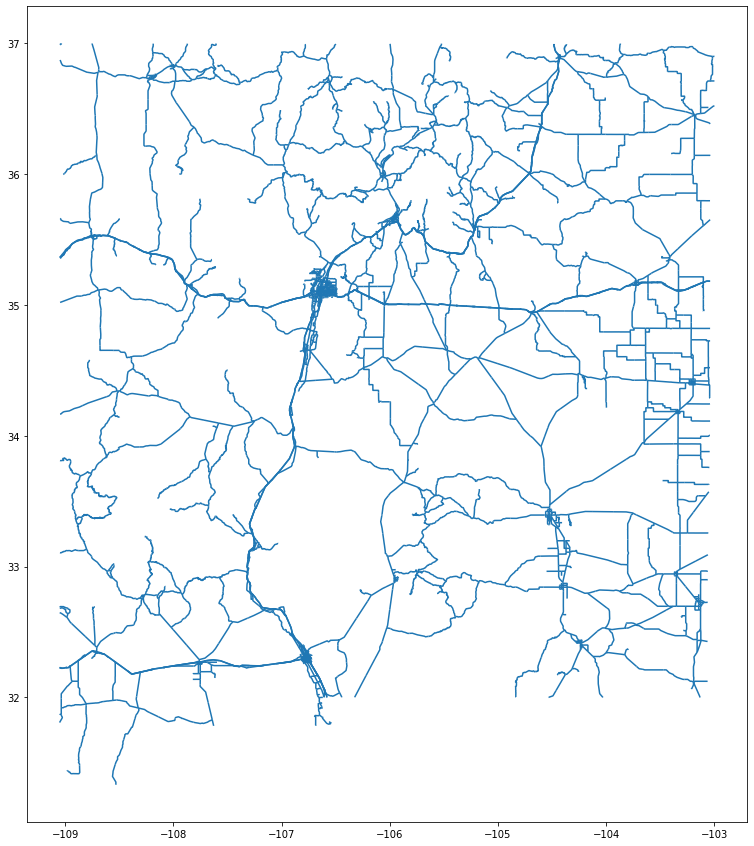

In [32]:
import matplotlib.pyplot as plt
%matplotlib inline
gdf.plot(figsize=(15,15))

In [33]:
## ----- Add Save to Shapefile Code Below -----------

gdf.to_file("new_mexico_roads.shp")

# Save Your Notebook
## Then Notebook Menu: File > Close and Halt

### Additional Resources
 * https://geohackweek.github.io/vector/03-encodings-libraries/